#   Lab 02: Feature extraction and embeddings

In [1]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.svm import LinearSVC
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GridSearchCV, cross_val_score


### A. Data Preparation

In [2]:
data = pd.read_csv('out.csv')
data.drop(['Unnamed: 0'],axis=1,inplace=True)
data

,id,text,author
0,id26305,this proces however afforded me no means of as...,EAP
1,id17569,it never once occurred to me that the fumbling...,HPL
2,id11008,in his left hand was a gold snuff box from whi...,EAP
3,id27763,how lovely is spring as we looked from windsor...,MWS
4,id12958,finding nothing else not even gold the superin...,HPL
...,...,...,...
19574,id17718,i could have fancied while i looked at it that...,EAP
19575,id08973,the lids clenched themselves together as if in...,EAP
19576,id05267,mais il faut agir that is to say a frenchman n...,EAP
19577,id17513,for an item of news like this it strikes us it...,EAP


### B. Encoding of the Target Variable

In [3]:
le = LabelEncoder()
data['author_encoded'] = le.fit_transform(data['author'])
data

,id,text,author,author_encoded
0,id26305,this proces however afforded me no means of as...,EAP,0
1,id17569,it never once occurred to me that the fumbling...,HPL,1
2,id11008,in his left hand was a gold snuff box from whi...,EAP,0
3,id27763,how lovely is spring as we looked from windsor...,MWS,2
4,id12958,finding nothing else not even gold the superin...,HPL,1
...,...,...,...,...
19574,id17718,i could have fancied while i looked at it that...,EAP,0
19575,id08973,the lids clenched themselves together as if in...,EAP,0
19576,id05267,mais il faut agir that is to say a frenchman n...,EAP,0
19577,id17513,for an item of news like this it strikes us it...,EAP,0


### C. Construction of Training and Testing Sets

In [4]:
X_train, X_test, y_train, y_test = train_test_split(data['text'].values, 
                                                    data['author_encoded'].values, 
                                                    test_size=0.2, 
                                                    random_state=33,
                                                    stratify = data['author_encoded'].values)

In [5]:
print(100*y_train.tolist().count(0)/(len(y_train)))
print(100*y_test.tolist().count(0)/(len(y_test)))

40.349869118304284
40.34729315628192


### D. Vectorization Methods

##### 1. Use the lexical frequency method and one-hot encoding to vectorize the training and testing datasets.

In [6]:
from sklearn.feature_extraction.text import CountVectorizer

# création d'un objet CountVectorizer pour effectuer la fréquence lexicale et l'encodage one-hot 
# (
#    si binary=False => fréquence lexicale
#    si binary=True => one-hot encoding
#)
vectorizer = CountVectorizer(binary=False,analyzer= 'word', stop_words='english')

# ajustement du vectorizer sur le texte d'entraînement
vectorizer.fit(X_train)

# transformation du texte d'entraînement et de test en vecteurs one-hot
train_cv = vectorizer.transform(X_train)
test_cv = vectorizer.transform(X_test)

In [7]:
count_array_cv = train_cv.toarray()
df = pd.DataFrame(data=count_array_cv,columns = vectorizer.get_feature_names_out())
df

,ab,aback,abandon,abandoned,abandoning,abandonment,abaout,abasement,abashed,abashment,...,zobnarian,zodiac,zodiacal,zoilus,zokar,zone,zones,zory,zubmizion,zuro
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15658,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
15659,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
15660,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
15661,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


##### 2 & 3. Train a TF-IDF vectorization model on the training part and vectorize it and vectorize the testing part

In [8]:
from sklearn.feature_extraction.text import TfidfVectorizer

# création d'un objet TfidfVectorizer pour effectuer la vectorisation TF-IDF
tfidf_vectorizer = TfidfVectorizer(analyzer= 'word', stop_words='english')

# ajustement du vectorizer sur le texte d'entraînement
tfidf_vectorizer.fit(X_train)

# transformation du texte d'entraînement et de test en vecteurs TF-IDF
train_tfidf = tfidf_vectorizer.transform(X_train)
test_tfidf = tfidf_vectorizer.transform(X_test)

In [9]:
count_array_tfidf = train_tfidf.toarray()
df = pd.DataFrame(data=count_array_tfidf,columns = tfidf_vectorizer.get_feature_names_out())
df

,ab,aback,abandon,abandoned,abandoning,abandonment,abaout,abasement,abashed,abashment,...,zobnarian,zodiac,zodiacal,zoilus,zokar,zone,zones,zory,zubmizion,zuro
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15658,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
15659,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
15660,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
15661,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


### E. Training

#### 1. Create three models of the MLPClassifier type. (You can change the learning algorithm: use other scikit-learn algorithms)

In [10]:
from sklearn.neural_network import MLPClassifier

# Modèle 1 : 1 couche cachée avec 100 neurones
model1 = MLPClassifier(hidden_layer_sizes=(100,), max_iter=200, solver='adam', random_state=1)

# Modèle 2 : 2 couches cachées avec 50 et 25 neurones, respectivement
model2 = MLPClassifier(hidden_layer_sizes=(50, 25), max_iter=200, solver='adam', random_state=1)

# Modèle 3 : 3 couches cachées avec 100, 50 et 25 neurones, respectivement
model3 = MLPClassifier(hidden_layer_sizes=(100, 50, 25), max_iter=200, solver='adam', random_state=1)


#### 2,3 & 4. 
 - Train these three models on the three vector representations.
 - Predict the classes by applying the three models to the three training representations.
 - Display the classification report using performance measures (accuracy, precision, recall...).

In [12]:
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
import pickle



# création des modèles avec différentes architectures de couches cachées
models = [
    model1,
    model2,
    model3
]

# entrainement des modèles sur les différentes représentations
representations = [(train_cv, test_cv),(train_tfidf, test_tfidf)]
for i, model in enumerate(models):
    print(f"Model {i+1}")
    for j, rep in enumerate(representations):
        
        # entraînement du modèle
        model.fit(rep[0], y_train)
        
        # prédiction sur le jeu de train
        y_pred = model.predict(rep[0])
        
        # évaluation de la performance du modèle
        
        print(f"Representation {j+1}:")
        print(classification_report(y_train, y_pred))

        
        # save the model to disk
        filename = f'models/finalized_model{i+1}.{j+1}.sav'
        pickle.dump(model, open(filename, 'wb'))


Model 1
Representation 1:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      6320
           1       1.00      1.00      1.00      4508
           2       1.00      1.00      1.00      4835

    accuracy                           1.00     15663
   macro avg       1.00      1.00      1.00     15663
weighted avg       1.00      1.00      1.00     15663

Representation 2:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      6320
           1       1.00      1.00      1.00      4508
           2       1.00      1.00      1.00      4835

    accuracy                           1.00     15663
   macro avg       1.00      1.00      1.00     15663
weighted avg       1.00      1.00      1.00     15663

Model 2
Representation 1:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      6320
           1       1.00      1.00      1.00      4508
     

In [15]:
import pickle
from sklearn.metrics import accuracy_score

#load the model from disk
filename = "models/finalized_model1.2.sav"
loaded_model = pickle.load(open(filename, 'rb'))
y_pred = loaded_model.predict(train_cv)

result = accuracy_score(y_pred, y_train)
print(result)

0.9983400370299432


### F. Testing


In [13]:
import time
import pickle
from sklearn.metrics import classification_report

for i in range(3):
    print('\n\n************************************************************')
    print(f"Pour Model N°{i+1} et La Representation 1 (CountVect ) et 2 (TF-IDF)")
    representations = [test_cv, test_tfidf]

    for j, rep in enumerate(representations):
        print(f"Representation {j+1}:")

        # load the model from disk
        filename = f"models/finalized_model{i+1}.{j+1}.sav"
        loaded_model = pickle.load(open(filename, 'rb'))
        
        # Model prediction time
        start_time = time.time()
        y_pred = loaded_model.predict(rep)
        end_time = time.time()

        result = classification_report(y_pred, y_test)
        print(result)
        print(f"Model {i+1} prediction time: {(end_time - start_time)} seconds")



************************************************************
Pour Model N°1 et La Representation 1 (CountVect ) et 2 (TF-IDF)
Representation 1:
              precision    recall  f1-score   support

           0       0.72      0.76      0.74      1511
           1       0.70      0.73      0.72      1084
           2       0.77      0.71      0.74      1321

    accuracy                           0.73      3916
   macro avg       0.73      0.73      0.73      3916
weighted avg       0.73      0.73      0.73      3916

Model 1 prediction time: 0.0 seconds
Representation 2:
              precision    recall  f1-score   support

           0       0.76      0.78      0.77      1532
           1       0.73      0.78      0.76      1054
           2       0.80      0.73      0.77      1330

    accuracy                           0.77      3916
   macro avg       0.77      0.77      0.76      3916
weighted avg       0.77      0.77      0.77      3916

Model 1 prediction time: 0.0059990882

### G. Vectorizations based on word embeddings

### Word2Vec

In [16]:
from gensim.models.word2vec import Word2Vec
from gensim.models import FastText, KeyedVectors

X_train_tokens = [text.split() for text in X_train]    
X_test_tokens = [text.split() for text in X_test]


# Skip-Gram
model_w2v_sg = Word2Vec(X_train_tokens, vector_size=200, window=5, min_count=1, workers=4, sg=1) 
# CBOW
model_w2v_cbow = Word2Vec(X_train_tokens, vector_size=200, window=5, min_count=1, workers=4, sg=0) 


### Glove model

In [28]:
#must run this command on glove.6B.100d.txt file
#download glove.6B.100d.txt from kaggle and place it in lab2 folder
!python -m  gensim.scripts.glove2word2vec -i glove.6B.100d.txt -o glove.6B.100d.word2vec.txt

2024-04-29 12:25:13,444 - glove2word2vec - INFO - running c:\Python311\Lib\site-packages\gensim\scripts\glove2word2vec.py -i glove.6B.100d.txt -o glove.6B.100d.word2vec.txt
c:\Python311\Lib\site-packages\gensim\scripts\glove2word2vec.py:125: DeprecationWarning: Call to deprecated `glove2word2vec` (KeyedVectors.load_word2vec_format(.., binary=False, no_header=True) loads GLoVE text vectors.).
  num_lines, num_dims = glove2word2vec(args.input, args.output)
2024-04-29 12:25:13,444 - keyedvectors - INFO - loading projection weights from glove.6B.100d.txt
2024-04-29 12:25:45,878 - utils - INFO - KeyedVectors lifecycle event {'msg': 'loaded (400000, 100) matrix of type float32 from glove.6B.100d.txt', 'binary': False, 'encoding': 'utf8', 'datetime': '2024-04-29T12:25:45.858322', 'gensim': '4.3.2', 'python': '3.11.4 (tags/v3.11.4:d2340ef, Jun  7 2023, 05:45:37) [MSC v.1934 64 bit (AMD64)]', 'platform': 'Windows-10-10.0.22631-SP0', 'event': 'load_word2vec_format'}
2024-04-29 12:25:45,878 - glo

In [26]:
model_glove = KeyedVectors.load_word2vec_format('glove.6B.100d.word2vec.txt', binary=False)


### FastText

In [29]:
model_fasttext = FastText(X_train_tokens, vector_size=200, window=5, min_count=1, workers=4)

## H. Training / Testing

### Visualization

In [30]:
from sklearn.decomposition import PCA

#pass the embeddings to PCA
pca = PCA(n_components=2)
result = pca.fit_transform(model_w2v_sg.wv.vectors)

#create df from the pca results
pca_df = pd.DataFrame(result, columns = ['x','y'])

#add the words for the hover effect
pca_df['word'] = model_w2v_sg.wv.index_to_key
pca_df.head()


,x,y,word
0,0.991814,-0.135516,the
1,0.979402,0.037267,of
2,0.883758,-0.061537,and
3,1.301585,0.877599,to
4,1.027505,0.035662,a


In [31]:
import plotly.graph_objs as go

N = 1000000
words = list(model_w2v_sg.wv.index_to_key)
fig = go.Figure(data=go.Scattergl(
   x = pca_df['x'],
   y = pca_df['y'],
   mode='markers',
   marker=dict(
       color=np.random.randn(N),
       colorscale='Viridis',
       line_width=1
   ),
   text=pca_df['word'],
   textposition="bottom center"
))

fig.show()

### Vectorizing our sentence (`Sentence --> Embedding Vector`)  by calculating the MEAN

In [32]:
def get_mean_vector(w2v_vectors, words):
    words = [word for word in words if word in w2v_vectors]
    if words:
        avg_vector = np.mean(w2v_vectors[words], axis=0)
    else:
        avg_vector = np.zeros_like(w2v_vectors['hi'])
    return avg_vector

Skip-Gram

In [33]:
import numpy as np
import pandas as pd

df_data = []
for token in X_train_tokens:
    df_data.append(get_mean_vector(model_w2v_sg.wv,token))
        
train_embeddings = pd.DataFrame(data={'Skip-Gram':df_data})

df_data = []
for token in X_test_tokens:
    df_data.append(get_mean_vector(model_w2v_sg.wv,token))
        
test_embeddings = pd.DataFrame(data={'Skip-Gram':df_data})

Cbow

In [34]:
df_data = []
for token in X_train_tokens:
    df_data.append(get_mean_vector(model_w2v_cbow.wv,token))
        
train_embeddings['Cbow'] = df_data

df_data = []
for token in X_test_tokens:
    df_data.append(get_mean_vector(model_w2v_cbow.wv,token))
        
test_embeddings['Cbow'] = df_data

FastText

In [35]:
df_data = []
for token in X_train_tokens:
    df_data.append(get_mean_vector(model_fasttext.wv,token))
        
train_embeddings['FastText'] = df_data

df_data = []
for token in X_test_tokens:
    df_data.append(get_mean_vector(model_fasttext.wv,token))
        
test_embeddings['FastText'] = df_data

In [36]:
train_embeddings['author'] = y_train
test_embeddings['author'] = y_test

In [37]:
train_embeddings

,Skip-Gram,Cbow,FastText,author
0,"[-0.09245351, -0.13474467, -0.19422822, 0.0571...","[0.076555416, -0.3873256, -0.21496993, 0.16724...","[-0.64794165, -0.2699343, 0.68553156, -0.05720...",0
1,"[-0.0138421515, -0.06436534, -0.1446154, 0.008...","[0.04013775, -0.14664431, -0.24667382, 0.26135...","[-0.450563, -0.1549467, 0.7243632, 0.004474306...",2
2,"[-0.016322251, -0.05566424, -0.13252683, 0.013...","[0.047090776, -0.123674214, -0.24026245, 0.220...","[-0.4520924, -0.12596405, 0.6855266, -0.043536...",2
3,"[0.042666577, -0.06912962, -0.14757802, 0.0211...","[0.200636, -0.39847913, -0.19032557, 0.0736103...","[-0.8359748, -0.5553028, 0.88246626, -0.073657...",2
4,"[0.030173779, -0.048087917, -0.13290967, 0.019...","[0.13835351, -0.24336997, -0.32883242, 0.23244...","[-0.51334476, -0.28475353, 0.9356317, -0.01246...",2
...,...,...,...,...
15658,"[0.037498757, -0.076692045, -0.16398796, 0.024...","[0.14120299, -0.2590958, -0.24012192, 0.126241...","[-0.55205256, -0.29024366, 0.69331557, -0.0324...",2
15659,"[0.008315314, -0.055191915, -0.119723015, 0.03...","[0.11323017, -0.2953621, -0.25744775, 0.208803...","[-0.60343003, -0.33598742, 0.8039362, -0.03032...",2
15660,"[-0.003307657, -0.08177994, -0.12526338, 0.078...","[0.074559696, -0.2186441, -0.22983482, 0.24306...","[-0.5472723, -0.20986466, 0.68265975, -0.04442...",0
15661,"[-0.016894873, -0.02929884, -0.09387635, 0.052...","[0.044977337, -0.16403587, -0.26551414, 0.2932...","[-0.44843885, -0.1873457, 0.7674887, -0.005266...",1


In [41]:
test_embeddings

,Skip-Gram,Cbow,FastText,author
0,"[-0.02533995, -0.057708997, -0.1383868, 0.0334...","[0.08728299, -0.23488268, -0.24730948, 0.19595...","[-0.5960142, -0.24000153, 0.7607671, -0.057615...",0
1,"[-0.013364219, -0.04435305, -0.115443155, 0.04...","[0.1310399, -0.28475758, -0.23302014, 0.156321...","[-0.76362294, -0.40808642, 0.93084824, -0.0655...",0
2,"[-0.038911216, -0.04846803, -0.10835905, 0.019...","[0.041968066, -0.27902886, -0.19055352, 0.2374...","[-0.4527249, -0.21626551, 0.5690407, 0.0437042...",1
3,"[0.02638327, -0.042123396, -0.106831744, 0.055...","[0.13256206, -0.25670433, -0.25646424, 0.21515...","[-0.5001691, -0.21661125, 0.6957603, -0.003744...",0
4,"[0.0032943068, -0.035050638, -0.14190407, 0.04...","[0.09842654, -0.1773736, -0.29563868, 0.256905...","[-0.6131109, -0.24261205, 0.8562926, -0.080922...",0
...,...,...,...,...
3911,"[0.011293744, -0.033249523, -0.13720067, 0.045...","[0.082615644, -0.3048804, -0.23068282, 0.23892...","[-0.6011191, -0.30326766, 0.7502945, -0.024315...",0
3912,"[-0.0038440789, -0.035394795, -0.12100706, 0.0...","[0.072965354, -0.24091473, -0.29348248, 0.3058...","[-0.5458445, -0.24774297, 0.8056308, -0.017394...",0
3913,"[0.02209774, -0.057479277, -0.11369388, -0.006...","[0.10891265, -0.24729455, -0.28157568, 0.22512...","[-0.49014255, -0.24898033, 0.73027086, -0.0010...",1
3914,"[-0.0031537581, -0.040496238, -0.09115279, 0.0...","[0.09743194, -0.21748036, -0.22617775, 0.15707...","[-0.529733, -0.24831183, 0.7210892, -0.0501421...",1


### Train and Test

Skip-Gram with MLP's

In [52]:
#Lets try to train our data using Skip-Gram
X_train =  pd.DataFrame(list(train_embeddings['Skip-Gram'])).reset_index(drop=True)
y_train = pd.DataFrame(train_embeddings['author'])

In [53]:
import tensorflow as tf
from tensorflow import keras
from keras.optimizers import Adam
from keras.losses import SparseCategoricalCrossentropy


mlp_model = keras.models.Sequential([
    keras.layers.Flatten(input_shape=(200,)),
    keras.layers.Dense(128, activation='relu'),
    keras.layers.Dense(64, activation='relu'),
    keras.layers.Dense(3, activation='softmax')
])

adam = Adam(learning_rate=0.01)
mlp_model.compile(loss=SparseCategoricalCrossentropy(), optimizer=adam, metrics=['accuracy'])

#adam_history = model_ADAM.fit(X_train, y_train, epochs=50, validation_data=(X_val, y_val))
skip_history = mlp_model.fit(X_train, y_train, epochs=50)

Epoch 1/50
490/490 [==============================] - 2s 2ms/step - loss: 0.8887 - accuracy: 0.5877
Epoch 2/50
490/490 [==============================] - 1s 1ms/step - loss: 0.8300 - accuracy: 0.6326
Epoch 3/50
490/490 [==============================] - 1s 2ms/step - loss: 0.8128 - accuracy: 0.6427
Epoch 4/50
490/490 [==============================] - 1s 1ms/step - loss: 0.8029 - accuracy: 0.6450
Epoch 5/50
490/490 [==============================] - 1s 1ms/step - loss: 0.7897 - accuracy: 0.6550
Epoch 6/50
490/490 [==============================] - 1s 1ms/step - loss: 0.7900 - accuracy: 0.6543
Epoch 7/50
490/490 [==============================] - 1s 1ms/step - loss: 0.7818 - accuracy: 0.6656
Epoch 8/50
490/490 [==============================] - 1s 2ms/step - loss: 0.7699 - accuracy: 0.6665
Epoch 9/50
490/490 [==============================] - 1s 2ms/step - loss: 0.7688 - accuracy: 0.6665
Epoch 10/50
490/490 [==============================] - 1s 2ms/step - loss: 0.7625 - accuracy: 0.6686

Cbow with MLP's

In [44]:
#Lets try to train our data using Skip-Gram
X_train =  pd.DataFrame(list(train_embeddings['Cbow'])).reset_index(drop=True)
y_train = pd.DataFrame(train_embeddings['author'])

In [45]:
import tensorflow as tf
from tensorflow import keras
from keras.optimizers import Adam
from keras.losses import SparseCategoricalCrossentropy


mlp_model = keras.models.Sequential([
    keras.layers.Flatten(input_shape=(200,)),
    keras.layers.Dense(128, activation='relu'),
    keras.layers.Dense(64, activation='relu'),
    keras.layers.Dense(3, activation='softmax')
])

adam = Adam(learning_rate=0.01)
mlp_model.compile(loss=SparseCategoricalCrossentropy(), optimizer=adam, metrics=['accuracy'])

#adam_history = model_ADAM.fit(X_train, y_train, epochs=50, validation_data=(X_val, y_val))
cbow_history = mlp_model.fit(X_train, y_train, epochs=50)

Epoch 1/50
490/490 [==============================] - 2s 2ms/step - loss: 1.0407 - accuracy: 0.4566
Epoch 2/50
490/490 [==============================] - 1s 1ms/step - loss: 1.0166 - accuracy: 0.4750
Epoch 3/50
490/490 [==============================] - 1s 2ms/step - loss: 1.0069 - accuracy: 0.4877
Epoch 4/50
490/490 [==============================] - 1s 2ms/step - loss: 0.9998 - accuracy: 0.4979
Epoch 5/50
490/490 [==============================] - 1s 2ms/step - loss: 0.9910 - accuracy: 0.5090
Epoch 6/50
490/490 [==============================] - 1s 2ms/step - loss: 0.9920 - accuracy: 0.5055
Epoch 7/50
490/490 [==============================] - 1s 3ms/step - loss: 0.9846 - accuracy: 0.5106
Epoch 8/50
490/490 [==============================] - 1s 3ms/step - loss: 0.9843 - accuracy: 0.5147
Epoch 9/50
490/490 [==============================] - 1s 3ms/step - loss: 0.9794 - accuracy: 0.5154
Epoch 10/50
490/490 [==============================] - 1s 2ms/step - loss: 0.9780 - accuracy: 0.5193

FastText with MLP's

In [46]:
#Lets try to train our data using Skip-Gram
X_train =  pd.DataFrame(list(train_embeddings['FastText'])).reset_index(drop=True)
y_train = pd.DataFrame(train_embeddings['author'])

In [47]:
import tensorflow as tf
from tensorflow import keras
from keras.optimizers import Adam
from keras.losses import SparseCategoricalCrossentropy


mlp_model = keras.models.Sequential([
    keras.layers.Flatten(input_shape=(200,)),
    keras.layers.Dense(128, activation='relu'),
    keras.layers.Dense(64, activation='relu'),
    keras.layers.Dense(3, activation='softmax')
])

adam = Adam(learning_rate=0.01)
mlp_model.compile(loss=SparseCategoricalCrossentropy(), optimizer=adam, metrics=['accuracy'])

#adam_history = model_ADAM.fit(X_train, y_train, epochs=50, validation_data=(X_val, y_val))
fasttext_history = mlp_model.fit(X_train, y_train, epochs=50)

Epoch 1/50
490/490 [==============================] - 3s 4ms/step - loss: 1.0596 - accuracy: 0.4386
Epoch 2/50
490/490 [==============================] - 1s 3ms/step - loss: 1.0309 - accuracy: 0.4731
Epoch 3/50
490/490 [==============================] - 1s 3ms/step - loss: 1.0265 - accuracy: 0.4751
Epoch 4/50
490/490 [==============================] - 1s 3ms/step - loss: 1.0179 - accuracy: 0.4830
Epoch 5/50
490/490 [==============================] - 1s 2ms/step - loss: 1.0179 - accuracy: 0.4846
Epoch 6/50
490/490 [==============================] - 1s 2ms/step - loss: 1.0160 - accuracy: 0.4847
Epoch 7/50
490/490 [==============================] - 1s 2ms/step - loss: 1.0124 - accuracy: 0.4905
Epoch 8/50
490/490 [==============================] - 1s 2ms/step - loss: 1.0119 - accuracy: 0.4926
Epoch 9/50
490/490 [==============================] - 1s 2ms/step - loss: 1.0118 - accuracy: 0.4918
Epoch 10/50
490/490 [==============================] - 1s 3ms/step - loss: 1.0099 - accuracy: 0.4915

### Results

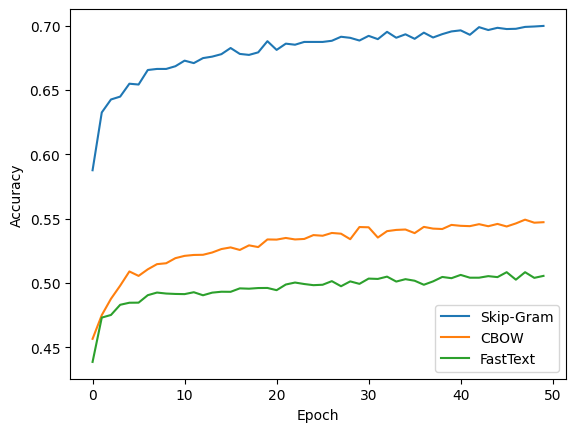

In [54]:
# Plot the training history for each optimizer
import matplotlib.pyplot as plt

plt.plot(pd.DataFrame(skip_history.history)[['accuracy']], label='Skip-Gram')
plt.plot(pd.DataFrame(cbow_history.history)[['accuracy']], label='CBOW')
plt.plot(pd.DataFrame(fasttext_history.history)[['accuracy',]], label='FastText')

plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()